# **Abstract**

This notebook is an analysis of various neural network architectures to identify musical symbols on a note sheet. Using different architectures allows us to identify the most effective of them for this case. Open datasets were used in the work.

## **☑ Dependencies**

For PC:

In [ ]:
!pip install tqdm seaborn pillow numpy troch matplotlib torchsummary

<hr>

In [1]:
!pip install torchshow

In [2]:
import os
import sys

from tqdm import tqdm
import seaborn as sns
# Pipeline
from PIL import Image, ImageDraw
import numpy as np
# NN
import torch
from torch import nn, optim
from torch.utils.data import DataLoader, Dataset, random_split
from torchvision.utils import draw_bounding_boxes
import torchvision.transforms as tr
from torchvision.transforms.v2 import GaussianNoise
import torchvision.ops as op
# Visualization
import matplotlib.pyplot as plt
import torchshow as ts
# NN Summary
from torchsummary import summary

For google colab:

In [3]:
# Dataset
from google.colab import drive

<hr>

In [4]:
sns.set(style='darkgrid')

device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda', index=0)

## **☑ Parametrs**

In [40]:
# Yolov1
IMAGE_SIZE = (448, 448)  # 448 in original
EXISTENCE_THRESHOLD = 0.4 # V1 -- 0.4; V352 - 0.25
BATCH_SIZE = 16  # in original article 64 but 16 is better
LR = 1e-4  # as in original article (10^-4)
EPOCHS = 135  # 135 in original
SAVE_PATH = r"/content/drive/My Drive/Colab Notebooks/MOSH2024DATASET"  # .pt or .pth

V1_LIST = {1: "brace", 2: "staff", 3: "clefCAlto", 4: "clefCTenor", 5: "clefG", 6: "clefF"}
# Yolov3
IMAGE_SIZE_V3 = (416, 416)
BATCH_SIZE_V3 = 8
V3_LIST26 = {1: "staff", 2: "clefCAlto", 3: "clefCTenor", 4: "clefG", 5: "clefF"}
V3_LIST52 = {
    1: 'ledgerLine',
    2: 'repeatDot',
    3: 'clef8', 4: 'clef15',
    5: 'slur',
    6: 'beam',
    7: 'timeSig0', 8: 'timeSig1', 9: 'timeSig2', 10: 'timeSig3', 11: 'timeSig4',
    12: 'timeSig5', 13: 'timeSig6', 14: 'timeSig7', 15: 'timeSig8', 16: 'timeSig9',
    17: 'timeSigCommon', 18: 'timeSigCutCommon',
    19: 'noteheadBlackOnLine', 20: 'noteheadBlackInSpace',
    21: 'noteheadHalfOnLine', 22: 'noteheadHalfInSpace',
    23: 'noteheadWholeOnLine', 24: 'noteheadWholeInSpace',
    25: 'noteheadDoubleWholeOnLine', 26: 'noteheadDoubleWholeInSpace',
    27: 'augmentationDot',
    28: 'tie',
    29: 'tremolo1', 30: 'tremolo2', 31: 'tremolo3', 32: 'tremolo4',
    33: 'flag8thUp', 34: 'flag16thUp', 35: 'flag32ndUp', 36: 'flag64thUp', 37: 'flag128thUp',
    38: 'flag8thDown', 39: 'flag16thDown', 40: 'flag32ndDown', 41: 'flag64thDown', 42: 'flag128thDown',
    43: 'accidentalFlat', 44: 'accidentalNatural', 45: 'accidentalSharp',
    46: 'accidentalDoubleSharp', 47: 'accidentalDoubleFlat',
    48: 'keyFlat', 49: 'keyNatural', 50: 'keySharp',
    51: 'articAccentAbove', 52: 'articAccentBelow', 53: 'articStaccatoAbove', 54: 'articStaccatoBelow',
    55: 'articTenutoAbove', 56: 'articTenutoBelow', 57: 'articStaccatissimoAbove', 58: 'articStaccatissimoBelow',
    59: 'articMarcatoAbove', 60: 'articMarcatoBelow',
    61: 'tuplet3', 62: 'tuplet6',
    63: 'restHBar', 64: 'restDoubleWhole', 65: 'restWhole', 66: 'restHalf', 67: 'restQuarter',
    68: 'rest8th', 69: 'rest16th', 70: 'rest32nd', 71: 'rest64th', 72: 'rest128th',
    73: 'dynamicP', 74: 'dynamicM', 75: 'dynamicF', 76: 'dynamicS', 77: 'dynamicZ', 78: 'dynamicR',
    79: 'ornamentTrill', 80: 'ornamentTurn', 81: 'ornamentTurnInverted', 82: 'ornamentMordent',
    83: 'stringsDownBow', 84: 'stringsUpBow',
    85: 'arpeggiato',
    86: 'tupletBracket',
    87: 'fingering0', 88: 'fingering1', 89: 'fingering2', 90: 'fingering3', 91: 'fingering4', 92: 'fingering5',
    93: 'tuplet1', 94: 'tuplet7', 95: 'tuplet8', 96: 'tuplet9'}
# Ds2 dense
PATH_DS2_DENSE_IMG = "/content/drive/My Drive/Colab Notebooks/MOSH2024DATASET/ds2_dense/images"
PATH_DS2_DENSE_JSON = "/content/drive/My Drive/Colab Notebooks/MOSH2024DATASET/ds2_dense/deepscores_train.json"
TESTPATH_DS2_DENSE_JSON = "/content/drive/My Drive/Colab Notebooks/MOSH2024DATASET/ds2_dense/deepscores_test.json"

PATH_TEST = "/content/drive/My Drive/Colab Notebooks/MOSH2024DATASET/test_img2.png"

In [6]:
V1_LIST_TRANSLATOR = dict()
for k in tqdm(V1_LIST.keys()):
  item = V1_LIST[k]
  V1_LIST_TRANSLATOR[item] = k

100%|██████████| 6/6 [00:00<00:00, 58389.38it/s]


In [7]:
V3_LIST_TRANSLATOR26 = dict()
for k in tqdm(V3_LIST26.keys()):
  item = V3_LIST26[k]
  V3_LIST_TRANSLATOR26[item] = k

100%|██████████| 5/5 [00:00<00:00, 61320.23it/s]


In [8]:
V3_LIST_TRANSLATOR52 = dict()
for k in tqdm(V3_LIST52.keys()):
  item = V3_LIST52[k]
  V3_LIST_TRANSLATOR52[item] = k

100%|██████████| 96/96 [00:00<00:00, 661171.07it/s]


# **Pipeline**

## *DeepScoresV2* *dense*

> *Dense size - 741.8 MB* <br> *Full size - 80.9 GB*

The DeepScoresV2 Dataset for Music Object Detection contains digitally rendered images of written sheet music, together with the corresponding ground truth to fit various types of machine learning models. A total of 151 Million different instances of music symbols, belonging to **135 different classes** are annotated. The total Dataset contains **255,385** Images. For most researches, the dense version, containing **1714** of the most diverse and interesting images, should suffice. TRAIN SIZE **1362**; TEST SIZE **352**

The dataset contains ground in the form of:

*   Non-oriented bounding boxes
*   Oriented bounding boxes
*   Semantic segmentation
*   Instance segmentation

Tools to work with the OBBS(Oriented Bounding Box Schema). *(https://github.com/yvan674/obb_anns.git)*

## **1** **INSTALLING**

### **☑ 1.1 OBBS Tools**

For google colab:

In [9]:
drive.mount("/content/drive")

Mounted at /content/drive


<hr>

In [10]:
!git clone https://github.com/yvan674/obb_anns.git

Cloning into 'obb_anns'...
remote: Enumerating objects: 341, done.
remote: Counting objects: 100% (63/63), done.
remote: Compressing objects: 100% (22/22), done.
remote: Total 341 (delta 47), reused 46 (delta 40), pack-reused 278 (from 1)
Receiving objects: 100% (341/341), 984.35 KiB | 7.57 MiB/s, done.
Resolving deltas: 100% (175/175), done.


In [11]:
sys.path.insert(0,'/content/obb_anns')  # "This will fix the issue about not able to find the library location" - StackOverflow

In [12]:
from obb_anns import OBBAnns

/content/obb_anns/obb_anns/obb_anns.py:33: UserWarning: polyiou was not found. Running with no support for metric calculations.
  warnings.warn(warning_string)


In [13]:
annotations = OBBAnns(PATH_DS2_DENSE_JSON)
annotations.load_annotations()

loading ann_info...
done! t=22.28s


In [14]:
annotations_test = OBBAnns(TESTPATH_DS2_DENSE_JSON)
annotations_test.load_annotations()

loading ann_info...
done! t=6.49s


In [15]:
annotations.visualize(img_idx=1, show=True)  # NOTE: Without this string OBBAnns doesn't
annotations_test.visualize(img_idx=1, show=True)

Creating transcription dict

In [16]:
all_categories = annotations.get_cats()
ids2labels = dict()
for ids in all_categories:
  ids2labels[ids] = all_categories[ids]["name"]

### **1.2 Dataset I**

Creating castom dataset class

In [ ]:
class DS2_Dense_Dataset(Dataset):
  def __init__(self, x_transform: tr.transforms = None, delta: tuple = None):
    # self._data = imgs
    self._xtr = x_transform
    self._size = 1362
    self._delta = delta  # x and y

  def __len__(self) -> int:
    return self._size  # ??

  def __getitem__(self, idx: int):
    # NOTE: Sorting in OBBAnns takes place in a certain way that differs from sorting in self._data.
    # Using self._data[idx] you get the wrong pairs of imgs and anns !!!
    img_name = annotations.get_imgs(idxs=[idx])[0]["filename"]  # only one img
    x = os.path.join(PATH_DS2_DENSE_IMG, img_name)
    x_img = Image.open(x)
    if self._delta:
      if x_img.size != (1960, 2772):
        size = x_img.size
        delta = (size[0] / IMAGE_SIZE[0], size[1] / IMAGE_SIZE[1])
      else:
        delta = self._delta
      raw_boxes = annotations.get_anns(img_idx=idx)["a_bbox"].tolist()
      resized_boxes = list()
      for box in raw_boxes:
        resized_coords = list()
        for idx_coord in range(0, 4, 2):  # len(box) always 4
          tr_coord_x = (box[idx_coord] / delta[0])
          tr_coord_y = (box[idx_coord + 1] / delta[1])
          resized_coords.append(tr_coord_x)
          resized_coords.append(tr_coord_y)
        resized_boxes.append(resized_coords)
      y_boxes = torch.Tensor(resized_boxes).to(device)
    else:
      y_boxes = torch.Tensor(annotations.get_anns(img_idx=idx)["a_bbox"].tolist()).to(device)
    y_labels = torch.Tensor(annotations.get_anns(img_idx=idx)["cat_id"].tolist()).to(device)
    if self._xtr:
      x_img = self._xtr(x_img).to(device)
    item = {
        "x": x_img,
        "y": {
            "boxes": y_boxes,
            "labels": y_labels,
        }
    }
    return item  # where x - normal note sheet and y is bounding dox coordinates and labels

In [ ]:
image_tr = tr.Compose([
    # tr.Resize(IMAGE_SIZE),
    tr.ToTensor(),
])

In [ ]:
dataset = DS2_Dense_Dataset(image_tr)  # delta=(1960 / IMAGE_SIZE[0], 2772 / IMAGE_SIZE[1])
# NOTE: As the size decreased, some of the boxes became negligibly small, and with crop, one of their sides was equal to 0.

<hr>

### **1.2 Class analysis**

In [ ]:
labels_x = list()
numof_y = list()
for idxs in tqdm(range(len(dataset))):
  for labels in dataset[idxs]["y"]["labels"]:
    elem = ids2labels[labels.item()]
    if elem in labels_x:
      numof_y[labels_x.index(elem)] += 1
    else:
      labels_x.append(elem)
      numof_y.append(1)

100%|██████████| 1362/1362 [25:57<00:00,  1.14s/it]


In [ ]:
FINDER_LIST_ID = [2, 3, 41, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 83, 108, 109, 110, 115, 116, 117, 118, 119, 121, 122, 124, 125]  # the symbols that we want to see on the entire sheet

100%|██████████| 136/136 [25:30<00:00, 11.25s/it]


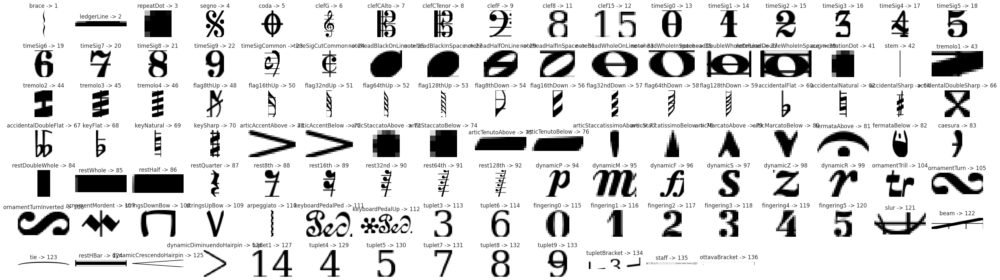

labels which wasn't find: ['clefUnpitchedPercussion', 'noteheadBlackOnLineSmall', 'noteheadBlackInSpaceSmall', 'noteheadHalfOnLineSmall', 'noteheadHalfInSpaceSmall', 'noteheadWholeOnLineSmall', 'noteheadWholeInSpaceSmall', 'noteheadDoubleWholeOnLineSmall', 'noteheadDoubleWholeInSpaceSmall', 'tremolo5', 'flag8thUpSmall', 'flag8thDownSmall', 'accidentalFlatSmall', 'accidentalNaturalSmall', 'accidentalSharpSmall', 'restHNr', 'graceNoteAcciaccaturaStemUp', 'graceNoteAppoggiaturaStemUp', 'graceNoteAcciaccaturaStemDown', 'graceNoteAppoggiaturaStemDown', 'tuplet2']


In [ ]:
plt.figure(figsize=(30,10))
idx = 0
lost_labels = list()
result_find = dict()
for id in tqdm(ids2labels.keys()):
  plt.subplot(8, 17, idx + 1)
  if ids2labels[id] not in labels_x:
    lost_labels.append(ids2labels[id])
    continue
  for img_idx in range(len(dataset)):
    labels = dataset[img_idx]["y"]["labels"].squeeze(-1).tolist()
    if img_idx % 100 == 0:
      # print(f"\n Current img: №{img_idx}")
      pass
    if id in labels:
      # print(f"Find img: №{img_idx}")
      label_idx = labels.index(id)
      box = dataset[img_idx]["y"]["boxes"][label_idx].tolist()
      img = dataset[img_idx]["x"]
      img_pil = tr.ToPILImage()(img)
      if id in FINDER_LIST_ID:
        draw = ImageDraw.Draw(img_pil)
        draw.rectangle(box, fill = (255, 0, 0), outline=(255, 0, 0), width=150)
        result_find[id] = img_pil
      label_idx = labels.index(id)
      img = tr.ToPILImage()(img).crop(box)
      plt.imshow(img)
      plt.title(f"{ids2labels[id]} -> {id}")
      plt.axis('off')
      idx += 1
      break

plt.tight_layout()
plt.show()

print(f"labels which wasn't find: {lost_labels}")

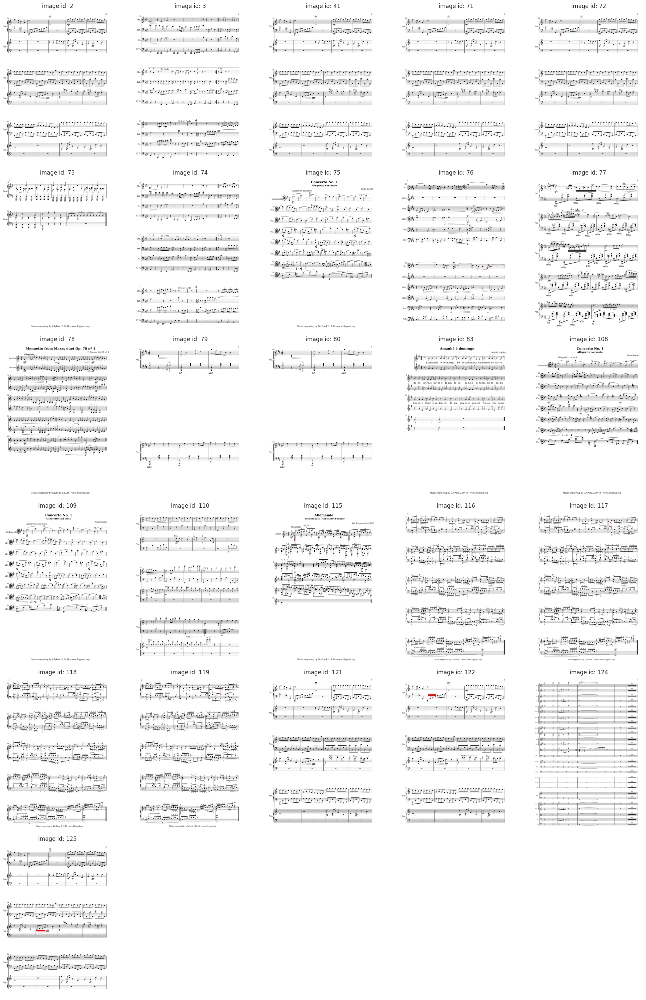

In [ ]:
# IMAGES X
plt.figure(figsize=(20, 30))
n = len(FINDER_LIST_ID)
idx = 0
# first 10 images
for id in FINDER_LIST_ID:
    plt.subplot(6, n // 5, idx + 1)
    img = result_find[id]
    plt.imshow(img)
    plt.title(f"image id: {id}")
    plt.axis('off')
    idx += 1

plt.tight_layout()
plt.show()

We have excluded the following characters

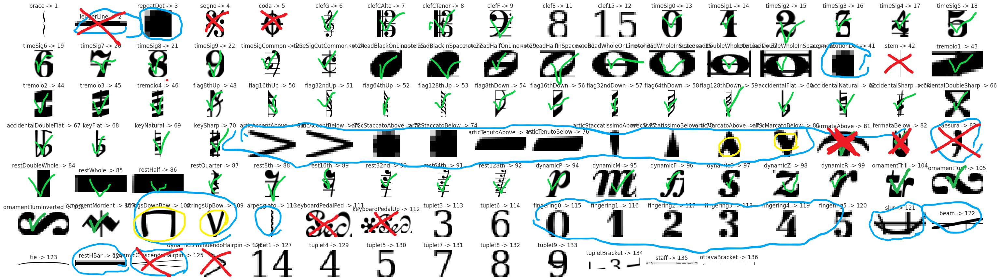

### **1.3 Dataset research**

In [ ]:
image_tr = tr.Compose([
    tr.Resize(IMAGE_SIZE),
    tr.ToTensor(),
])

In [ ]:
dataset = DS2_Dense_Dataset(image_tr, (1960 / IMAGE_SIZE[0], 2772 / IMAGE_SIZE[1]))

*Images*

**Not all images are the same size!!**

In [ ]:
pil_i = Image.open(os.path.join(PATH_DS2_DENSE_IMG, "lg-915061763362066826-aug-gutenberg1939--page-1.png"))
pil_i.size

(1960, 2772)

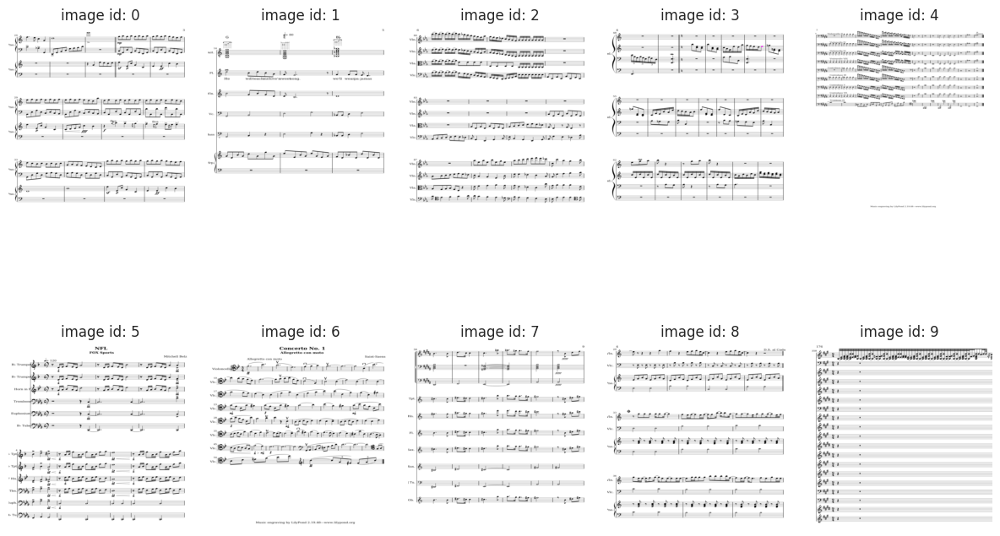

In [ ]:
# IMAGES X
plt.figure(figsize=(12,9))
# first 10 images
for idx in range(10):
    plt.subplot(2, 5, idx + 1)
    img = dataset[idx]["x"]
    plt.imshow(tr.ToPILImage()(img))
    plt.title(f"image id: {idx}")
    plt.axis('off')

plt.tight_layout()
plt.show()

In [ ]:
dataset[0]["y"]["boxes"][0]

tensor([ 21.2571,  26.5051, 426.5143,  37.3333])

torch.Size([3, 448, 448])
torch.Size([3, 448, 448])
torch.Size([3, 448, 448])
torch.Size([3, 448, 448])
torch.Size([3, 448, 448])
torch.Size([3, 448, 448])
torch.Size([3, 448, 448])
torch.Size([3, 448, 448])
torch.Size([3, 448, 448])
torch.Size([3, 448, 448])


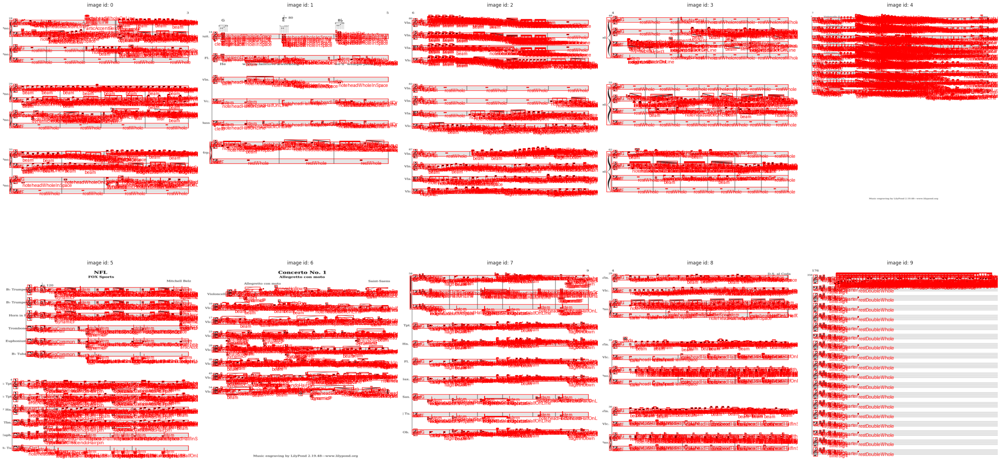

In [ ]:
# IMAGES Y with Boxes
plt.figure(figsize=(36, 21))
# first 4 images
for idx in range(10):
    plt.subplot(2, 5, idx + 1)
    img_x = dataset[idx]["x"]
    img_y = dataset[idx]["y"]
    colors = ["red" for _ in range(len(img_y["boxes"]))]
    labels = [ids2labels[id.item()] for id in img_y["labels"]]
    img_bb = draw_bounding_boxes(img_x, img_y["boxes"], labels, colors=colors, width=1)
    print(img_x.shape)
    img = tr.ToPILImage()(img_bb)
    plt.imshow(img)
    plt.title(f"image id: {idx}")
    plt.axis('off')

plt.tight_layout()
plt.show()

<hr>

*Charts*

In [ ]:
print(f'Find:{len(labels_x)} Real:{len(ids2labels.keys())}')  # Check

Find:115 Real:136


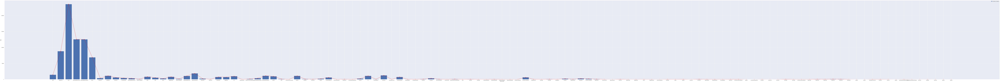

In [ ]:
plt.figure(figsize=(300, 24))
plt.plot(labels_x, numof_y, color='red', marker='o', markersize=7)
plt.bar(labels_x, numof_y, label="Number of objects")

plt.xlabel("Class name")
plt.ylabel("Num")
plt.legend()
plt.show()

Click on the chart to view more

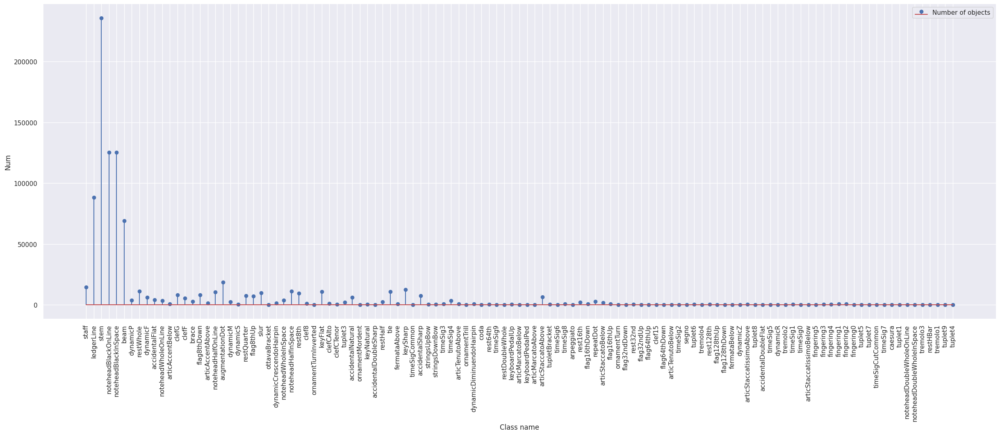

In [ ]:
plt.figure(figsize=(30, 10))
plt.stem(labels_x, numof_y, label="Number of objects")

plt.xlabel("Class name")
plt.xticks(rotation='vertical')
plt.ylabel("Num")
plt.legend()
plt.show()

## **☑ 2. Dataset II**

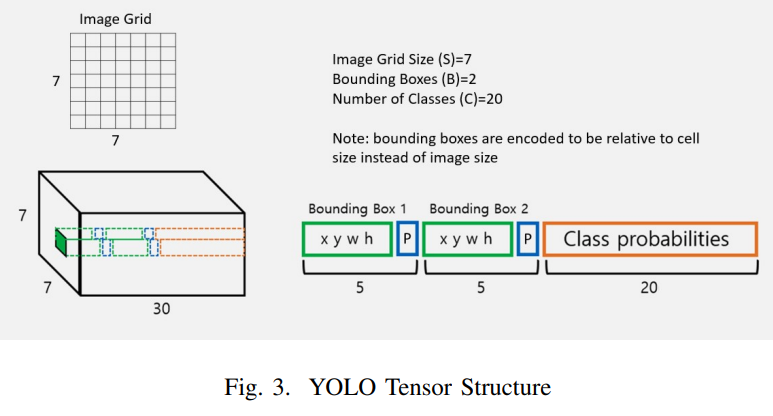

In [17]:
V1_LIST_KEYS = V1_LIST_TRANSLATOR.keys()
V3_LIST_KEYS26 = V3_LIST_TRANSLATOR26.keys()
V3_LIST_KEYS52 = V3_LIST_TRANSLATOR52.keys()

In [18]:
# Copy
image_tr = tr.Compose([
    tr.ColorJitter(brightness=(0.7, 1), contrast=0.4,saturation=0, hue=0.4),
    tr.Resize(IMAGE_SIZE_V3),
    tr.ToTensor(),
    GaussianNoise(),
    # tr.Normalize(mean=mean, std=std,),
])

### V1

In [ ]:
class DS2_Dense_Dataset_V1(Dataset):
  def __init__(self, n_classes: int, x_transform: tr.transforms = None, delta: tuple = None):
    # self._data = imgs
    self._xtr = x_transform
    self._size = 1362
    self._delta = delta  # x and y
    self.C = n_classes  # number of classes
    self.B = 2
    self.S = 7

  def __len__(self) -> int:
    return self._size  # ??

  def __getitem__(self, idx: int):
    # NOTE: Sorting in OBBAnns takes place in a certain way that differs from sorting in self._data.
    # Using self._data[idx] you get the wrong pairs of imgs and anns !!!
    img_name = annotations.get_imgs(idxs=[idx])[0]["filename"]  # only one img
    x = os.path.join(PATH_DS2_DENSE_IMG, img_name)
    x_img = Image.open(x)
    if self._delta:
      if x_img.size != (1960, 2772):
        size = x_img.size
        delta = (size[0] / IMAGE_SIZE[0], size[1] / IMAGE_SIZE[1])
      else:
        delta = self._delta
      raw_boxes = annotations.get_anns(img_idx=idx)["a_bbox"].tolist()
      resized_boxes = list()
      for box in raw_boxes:
        resized_coords = list()
        for idx_coord in range(0, 4, 2):  # len(box) always 4
          tr_coord_x = box[idx_coord] / delta[0]
          tr_coord_y = box[idx_coord + 1] / delta[1]
          resized_coords.append(tr_coord_x)
          resized_coords.append(tr_coord_y)
        resized_boxes.append(resized_coords)
      y_boxes = resized_boxes
    else:
      y_boxes = annotations.get_anns(img_idx=idx)["a_bbox"].tolist()
    y_labels = annotations.get_anns(img_idx=idx)["cat_id"].tolist()
    if self._xtr:
      x_img = self._xtr(x_img).to(device)
    matrix = self.format_matrix(y_labels, y_boxes)
    return x_img, matrix # where x - normal note sheet and y is bounding dox coordinates and labels

  def format_matrix(self, labels, boxes):
    matrix = torch.zeros((self.S, self.S, self.C + (5 * self.B)))
    delta_c = IMAGE_SIZE[0] / self.S
    for box in boxes:
      label = int(labels[boxes.index(box)][0])
      x0, y0, x1, y1 = box
      width = x1 - x0
      height = y1 - y0
      x_center, y_center = ((x0 + (width / 2)), (y0 + (height / 2)))
      # Translate coords to cells
      i, j = int(y_center / delta_c), int(x_center / delta_c)  # i - row and j - column
      x_cell = (x_center / delta_c) - j  # in cell
      y_cell = (y_center / delta_c) - i
      width_cell = (width / delta_c)
      height_cell = (height / delta_c)
      lbl = ids2labels[label]
      if matrix[i, j, 4] == 0 and (lbl in V1_LIST_KEYS):  # only one object per cell
         matrix[i, j, 4] = 1
         box_tensor = torch.Tensor([x_cell, y_cell, width_cell, height_cell])
         matrix[i, j, :4] = box_tensor
         # one hot encoding
         translated_idx = V1_LIST_TRANSLATOR[lbl] - 1
         matrix[i, j, (5 * self.B) + translated_idx] = 1
    return matrix


In [ ]:
# Copy
image_tr2 = tr.Compose([
    tr.Resize(IMAGE_SIZE),
    tr.ToTensor(),
])

In [ ]:
dataset2 = DS2_Dense_Dataset_V1(len(V1_LIST), image_tr2, (1960 / IMAGE_SIZE[0], 2772 / IMAGE_SIZE[1]))

In [ ]:
dataset2[0][1].shape

torch.Size([7, 7, 16])

In [ ]:
train_loader = DataLoader(dataset2, batch_size=BATCH_SIZE, shuffle=True)  # num_workers=2, pin_memory=True

### V3 26

In [ ]:
class DS2_Dense_Dataset_V326(Dataset):
  def __init__(self, size: int, n_classes: int, x_transform: tr.transforms = None, delta: tuple = None):
    # self._data = imgs
    self._xtr = x_transform
    self._size = size
    self._delta = delta  # x and y
    self.C = n_classes  # number of classes
    self.B = 2
    self.S = 26 ## ?

  def __len__(self) -> int:
    return self._size  # ??

  def __getitem__(self, idx: int):
    # NOTE: Sorting in OBBAnns takes place in a certain way that differs from sorting in self._data.
    # Using self._data[idx] you get the wrong pairs of imgs and anns !!!
    if self._size == 352:
      ann_res = annotations_test
    else:
      ann_res = annotations
    img_name = ann_res.get_imgs(idxs=[idx])[0]["filename"]  # only one img
    x = os.path.join(PATH_DS2_DENSE_IMG, img_name)
    x_img = Image.open(x)
    if self._delta:
      if x_img.size != (1960, 2772):
        size = x_img.size
        delta = (size[0] / IMAGE_SIZE[0], size[1] / IMAGE_SIZE[1])
      else:
        delta = self._delta
      raw_boxes = ann_res.get_anns(img_idx=idx)["a_bbox"].tolist()
      resized_boxes = list()
      for box in raw_boxes:
        resized_coords = list()
        for idx_coord in range(0, 4, 2):  # len(box) always 4
          tr_coord_x = box[idx_coord] / delta[0]
          tr_coord_y = box[idx_coord + 1] / delta[1]
          resized_coords.append(tr_coord_x)
          resized_coords.append(tr_coord_y)
        resized_boxes.append(resized_coords)
      y_boxes = resized_boxes
    else:
      y_boxes = ann_res.get_anns(img_idx=idx)["a_bbox"].tolist()
    y_labels = ann_res.get_anns(img_idx=idx)["cat_id"].tolist()
    if self._xtr:
      x_img = self._xtr(x_img).to(device)
    matrix = self.format_matrix(y_labels, y_boxes)
    return x_img, matrix # where x - normal note sheet and y is bounding dox coordinates and labels

  def format_matrix(self, labels, boxes):
    matrix = torch.zeros((self.S, self.S, self.C + (5 * self.B)))
    delta_c = IMAGE_SIZE[0] / self.S
    for box in boxes:
      label = int(labels[boxes.index(box)][0])
      x0, y0, x1, y1 = box
      width = x1 - x0
      height = y1 - y0
      x_center, y_center = ((x0 + (width / 2)), (y0 + (height / 2)))
      # Translate coords to cells
      i, j = int(y_center / delta_c), int(x_center / delta_c)  # i - row and j - column
      x_cell = (x_center / delta_c) - j  # in cell
      y_cell = (y_center / delta_c) - i
      width_cell = (width / delta_c)
      height_cell = (height / delta_c)
      lbl = ids2labels[label]
      if matrix[i, j, 4] == 0 and (lbl in V3_LIST_KEYS26):  # only one object per cell
         matrix[i, j, 4] = 1
         box_tensor = torch.Tensor([x_cell, y_cell, width_cell, height_cell])
         matrix[i, j, :4] = box_tensor
         # one hot encoding
         translated_idx = V3_LIST_TRANSLATOR26[lbl] - 1
         matrix[i, j, (5 * self.B) + translated_idx] = 1
    return matrix

In [ ]:
dataset326 = DS2_Dense_Dataset_V326(1362, len(V3_LIST26), image_tr, (1960 / IMAGE_SIZE_V3[0], 2772 / IMAGE_SIZE_V3[1]))
train_loader326 = DataLoader(dataset326, batch_size=BATCH_SIZE_V3, shuffle=True)  # num_workers=2, pin_memory=True

In [ ]:
valid_dataset26 = DS2_Dense_Dataset_V326(352, len(V3_LIST26), image_tr, (1960 / IMAGE_SIZE_V3[0], 2772 / IMAGE_SIZE_V3[1]))
valid_loader26 = DataLoader(valid_dataset26, batch_size=BATCH_SIZE_V3, shuffle=False)

### V3 52

In [19]:
class DS2_Dense_Dataset_V352(Dataset):
  def __init__(self, size: int, n_classes: int, x_transform: tr.transforms = None, delta: tuple = None):
    # self._data = imgs
    self._xtr = x_transform
    self._size = size
    self._delta = delta  # x and y
    self.C = n_classes  # number of classes
    self.B = 2
    self.S = 52 ## ?

  def __len__(self) -> int:
    return self._size  # ??

  def __getitem__(self, idx: int):
    # NOTE: Sorting in OBBAnns takes place in a certain way that differs from sorting in self._data.
    # Using self._data[idx] you get the wrong pairs of imgs and anns !!!
    if self._size == 352:
      ann_res = annotations_test
    else:
      ann_res = annotations
    img_name = ann_res.get_imgs(idxs=[idx])[0]["filename"]  # only one img
    x = os.path.join(PATH_DS2_DENSE_IMG, img_name)
    x_img = Image.open(x)
    if self._delta:
      if x_img.size != (1960, 2772):
        size = x_img.size
        delta = (size[0] / IMAGE_SIZE[0], size[1] / IMAGE_SIZE[1])
      else:
        delta = self._delta
      raw_boxes = ann_res.get_anns(img_idx=idx)["a_bbox"].tolist()
      resized_boxes = list()
      for box in raw_boxes:
        resized_coords = list()
        for idx_coord in range(0, 4, 2):  # len(box) always 4
          tr_coord_x = box[idx_coord] / delta[0]
          tr_coord_y = box[idx_coord + 1] / delta[1]
          resized_coords.append(tr_coord_x)
          resized_coords.append(tr_coord_y)
        resized_boxes.append(resized_coords)
      y_boxes = resized_boxes
    else:
      y_boxes = ann_res.get_anns(img_idx=idx)["a_bbox"].tolist()
    y_labels = ann_res.get_anns(img_idx=idx)["cat_id"].tolist()
    if self._xtr:
      x_img = self._xtr(x_img).to(device)
    matrix = self.format_matrix(y_labels, y_boxes)
    return x_img, matrix # where x - normal note sheet and y is bounding dox coordinates and labels

  def format_matrix(self, labels, boxes):
    matrix = torch.zeros((self.S, self.S, self.C + (5 * self.B)))
    delta_c = IMAGE_SIZE[0] / self.S
    for box in boxes:
      label = int(labels[boxes.index(box)][0])
      x0, y0, x1, y1 = box
      width = x1 - x0
      height = y1 - y0
      x_center, y_center = ((x0 + (width / 2)), (y0 + (height / 2)))
      # Translate coords to cells
      i, j = int(y_center / delta_c), int(x_center / delta_c)  # i - row and j - column
      x_cell = (x_center / delta_c) - j  # in cell
      y_cell = (y_center / delta_c) - i
      width_cell = (width / delta_c)
      height_cell = (height / delta_c)
      lbl = ids2labels[label]
      if matrix[i, j, 4] == 0 and (lbl in V3_LIST_KEYS52):  # only one object per cell
         matrix[i, j, 4] = 1
         box_tensor = torch.Tensor([x_cell, y_cell, width_cell, height_cell])
         matrix[i, j, :4] = box_tensor
         # one hot encoding
         translated_idx = V3_LIST_TRANSLATOR52[lbl] - 1
         matrix[i, j, (5 * self.B) + translated_idx] = 1
    return matrix

In [20]:
dataset352 = DS2_Dense_Dataset_V352(1362, len(V3_LIST52), image_tr, (1960 / IMAGE_SIZE_V3[0], 2772 / IMAGE_SIZE_V3[1]))
train_loader352= DataLoader(dataset352, batch_size=BATCH_SIZE_V3, shuffle=True)  # num_workers=2, pin_memory=True

In [21]:
valid_dataset352 = DS2_Dense_Dataset_V352(352, len(V3_LIST52), image_tr, (1960 / IMAGE_SIZE_V3[0], 2772 / IMAGE_SIZE_V3[1]))
valid_loader352 = DataLoader(valid_dataset352, batch_size=BATCH_SIZE_V3, shuffle=False)

# **Models**

## **1.1 YOLOv1**

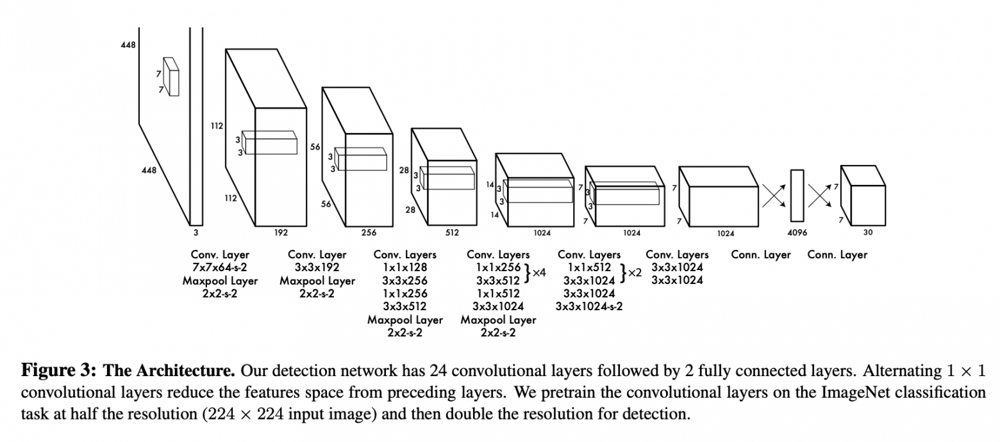

**Reduce 4096 to 496 otherwise model will predict simmilar results for each img!!**

In [ ]:
class ConvCombo(nn.Module):
  def __init__(self, in_channels: int, out_channels: int, kernel_size: int, stride: int = 1, padding=1):
    super().__init__()
    self._stack = nn.Sequential(
        nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, stride=stride, padding=padding, bias=False),
        nn.BatchNorm2d(out_channels),
        nn.LeakyReLU(0.1),
    )
  def forward(self, x):
    return self._stack(x)

class YOLOv1(nn.Module):
  def __init__(self, S: int=7, C: int=20, B: int=2):  # as it was in original article
    super().__init__()
    self._conv_stack = nn.Sequential(
        ConvCombo(in_channels=3, out_channels=64, kernel_size=S, stride=2, padding=3),
        nn.MaxPool2d(kernel_size=2, stride=2),
        ConvCombo(in_channels=64, out_channels=192, kernel_size=3),
        nn.MaxPool2d(kernel_size=2, stride=2),
        ConvCombo(in_channels=192, out_channels=128, kernel_size=1, padding=0),
        ConvCombo(in_channels=128, out_channels=256, kernel_size=3),
        ConvCombo(in_channels=256, out_channels=256, kernel_size=1, padding=0),
        ConvCombo(in_channels=256, out_channels=512, kernel_size=3),
        nn.MaxPool2d(kernel_size=2, stride=2),
        # x4 ->
        ConvCombo(in_channels=512, out_channels=256, kernel_size=1, padding=0),
        ConvCombo(in_channels=256, out_channels=512, kernel_size=3),
        ConvCombo(in_channels=512, out_channels=256, kernel_size=1, padding=0),
        ConvCombo(in_channels=256, out_channels=512, kernel_size=3),
        ConvCombo(in_channels=512, out_channels=256, kernel_size=1, padding=0),
        ConvCombo(in_channels=256, out_channels=512, kernel_size=3),
        ConvCombo(in_channels=512, out_channels=256, kernel_size=1, padding=0),
        ConvCombo(in_channels=256, out_channels=512, kernel_size=3),
        # <-
        ConvCombo(in_channels=512, out_channels=512, kernel_size=1, padding=0),
        ConvCombo(in_channels=512, out_channels=1024, kernel_size=3),
        nn.MaxPool2d(kernel_size=2, stride=2),
        # x2 ->
        ConvCombo(in_channels=1024, out_channels=512, kernel_size=1, padding=0),
        ConvCombo(in_channels=512, out_channels=1024, kernel_size=3),
        ConvCombo(in_channels=1024, out_channels=512, kernel_size=1, padding=0),
        ConvCombo(in_channels=512, out_channels=1024, kernel_size=3),
        # <-
        ConvCombo(in_channels=1024, out_channels=1024, kernel_size=3),
        ConvCombo(in_channels=1024, out_channels=1024, kernel_size=3, stride=2, padding=1),
        ConvCombo(in_channels=1024, out_channels=1024, kernel_size=3, padding=1),
        ConvCombo(in_channels=1024, out_channels=1024, kernel_size=3),
    )
    self._conn_stack = nn.Sequential(
        nn.Flatten(),  # Flattens a contiguous range of dims into a tensor
        nn.Linear(in_features=(1024 * S * S), out_features=496),
        nn.Dropout(0.0),
        nn.LeakyReLU(0.1),
        nn.Linear(in_features=496, out_features=(S * S * (B * 5 + C))),
    )

  def forward(self, x):
    out = self._conv_stack(x)
    out = self._conn_stack(out)
    return out

  def process(self, x):
    return self(x)

In [ ]:
yolov1 = YOLOv1(7, len(V1_LIST), 2).to(device)
summary(yolov1, (3, IMAGE_SIZE[0], IMAGE_SIZE[1]))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 224, 224]           9,408
       BatchNorm2d-2         [-1, 64, 224, 224]             128
         LeakyReLU-3         [-1, 64, 224, 224]               0
         ConvCombo-4         [-1, 64, 224, 224]               0
         MaxPool2d-5         [-1, 64, 112, 112]               0
            Conv2d-6        [-1, 192, 112, 112]         110,592
       BatchNorm2d-7        [-1, 192, 112, 112]             384
         LeakyReLU-8        [-1, 192, 112, 112]               0
         ConvCombo-9        [-1, 192, 112, 112]               0
        MaxPool2d-10          [-1, 192, 56, 56]               0
           Conv2d-11          [-1, 128, 56, 56]          24,576
      BatchNorm2d-12          [-1, 128, 56, 56]             256
        LeakyReLU-13          [-1, 128, 56, 56]               0
        ConvCombo-14          [-1, 128,

Output: 7 x 7 x 16
Input: 3 x 448 x 448

Therefore, 64 x 64 pixels per cell

## **1.2 YOLOv3**

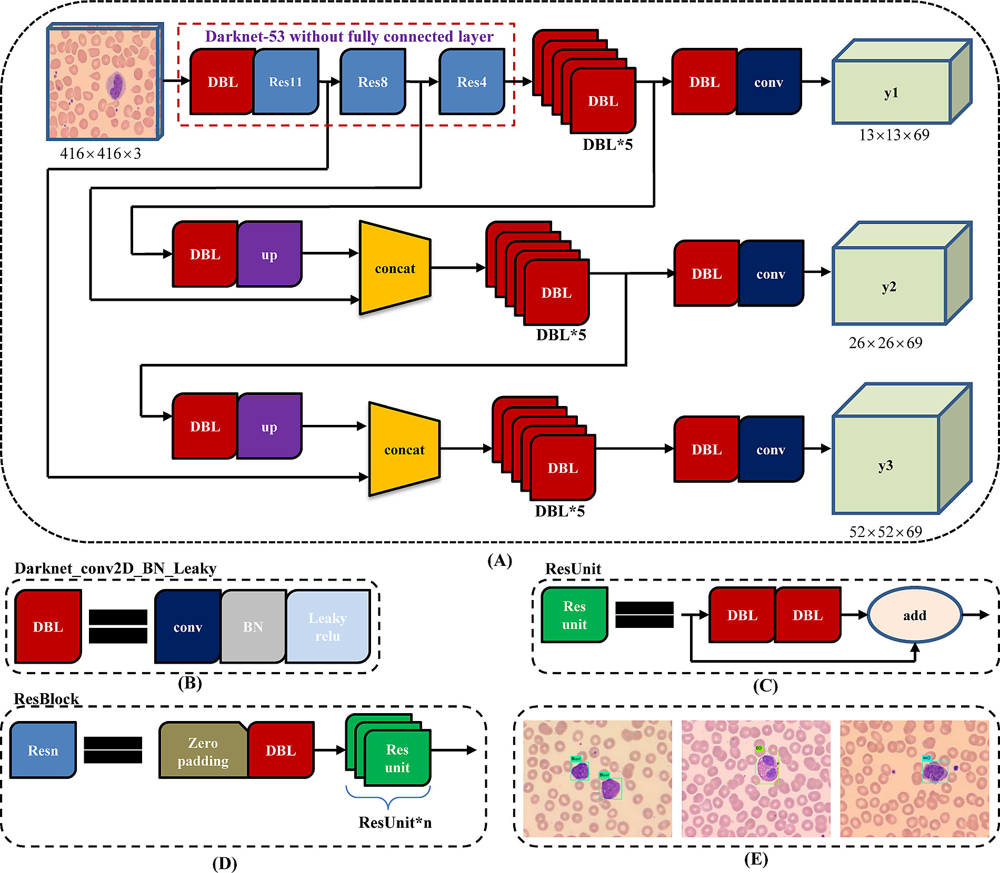



> In one pass we can go from an input image to the output tensor which corresponds to the detections for the image. Also, it is worth mentioning that YOLOv3 predicts boxes at 3 different scales.In the above figure it is represented by y1,y2 and y3.
> Using the COCO dataset, YOLOv3 predicts 80 different classes. YOLO outputs bounding boxes and class prediction as well. If we split an image into a 13 x 13 grid of cells and use 3 anchors box, the total output prediction is 13 x 13 x 3 or 169 x 3. However, YOLOv3 uses 3 different prediction scales which splits an image into (13 x 13), (26 x 26) and (52 x 52) grid of cells and with 3 anchors for each scale. So, the total output prediction will be((52 x 52) + (26 x 26) + 13 x 13)) x 3 = 10647 bounding boxes. [ [5] ](https://www.kaggle.com/code/arunmohan003/yolo-v3-pytorch-tutorial-from-scratch/notebook)



In [22]:
class Convolutional(nn.Module):  # DBL
  def __init__(self, in_channels: int, out_channels: int, kernel_size: int, stride: int = 1, padding=1, bias=False):
    super().__init__()
    self._stack = nn.Sequential(
        nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, stride=stride, padding=padding, bias=bias),
        nn.BatchNorm2d(out_channels),
        nn.LeakyReLU(0.1),
    )
  def forward(self, x):
    return self._stack(x)

In [23]:
class Detection(nn.Module):
  def __init__(self, in_channels: int, C, B):  # where A is number of anchors
    super().__init__()
    out_channels = in_channels // 2
    self.stack = nn.Sequential(
        Convolutional(in_channels=in_channels, out_channels=out_channels, kernel_size=1, padding=0),
        Convolutional(in_channels=out_channels, out_channels=in_channels, kernel_size=3),
        nn.Conv2d(in_channels=in_channels, out_channels=((B * 5) + C), kernel_size=1, padding=0)
    )

  def forward(self, x):
    out = self.stack(x)
    # print(out.shape)
    out = out.reshape(-1, out.shape[2], out.shape[2], out.shape[1])
    return out

class FPN(nn.Module):
  def __init__(self, in_channels, out_channels):
    super().__init__()
    self.conv1 = Convolutional(in_channels=in_channels, out_channels=out_channels, kernel_size=1, padding=0)
    self.up = nn.ConvTranspose2d(out_channels, out_channels, kernel_size=2, stride=2)
    self.conv3 = Convolutional(in_channels=(out_channels * 2), out_channels=out_channels, kernel_size=3)

  def forward(self, x, skip):
    x = self.conv1(x)
    x = self.up(x)
    out = torch.cat([x, skip], dim=1)
    out = self.conv3(out)
    return out


class DBLx5(nn.Module):
  def __init__(self, in_channels):
    super().__init__()
    out_channels = in_channels // 2
    self.stack = nn.Sequential(
        Convolutional(in_channels=in_channels, out_channels=out_channels, kernel_size=1, stride=1),
        Convolutional(in_channels=out_channels, out_channels=in_channels, kernel_size=3, stride=1),
        Convolutional(in_channels=in_channels, out_channels=out_channels, kernel_size=1, stride=1),
        Convolutional(in_channels=out_channels, out_channels=in_channels, kernel_size=3, stride=1),
        Convolutional(in_channels=in_channels, out_channels=in_channels, kernel_size=1, stride=1)
    )

  def forward(self, x):
    out = self.stack(x)
    return x


### *Darknet-53*

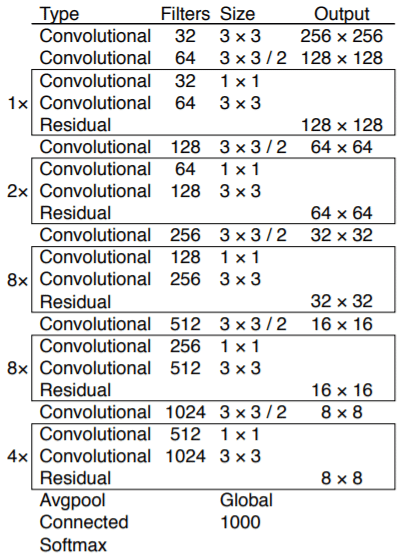

In [24]:
class Residual(nn.Module):  # ResUnit
  def __init__(self, in_channels: int):
    super().__init__()
    self._conv_stack = nn.Sequential(
        Convolutional(in_channels=in_channels, out_channels=(in_channels // 2), kernel_size=1, padding=0),
        Convolutional(in_channels=(in_channels // 2), out_channels=in_channels, kernel_size=3, padding=1),
    )

  def forward(self, x):
    out = self._conv_stack(x)
    return x + out


class Darknet(nn.Module):
  def __init__(self, is_train=False, weights=None, C:int =None):
    super().__init__()
    # Res11
    self.stack_list1 = nn.Sequential(
        Convolutional(in_channels=3, out_channels=32, kernel_size=3),
        Convolutional(in_channels=32, out_channels=64, kernel_size=3, stride=2),
        Residual(64),
        Convolutional(in_channels=64, out_channels=128, kernel_size=3, stride=2),
        *[Residual(128) for _ in range(2)],
        Convolutional(in_channels=128, out_channels=256, kernel_size=3, stride=2),
        *[Residual(256) for _ in range(8)],
    )
    # Res 8
    self.stack_list2 = nn.Sequential(
        Convolutional(in_channels=256, out_channels=512, kernel_size=3, stride=2),
        *[Residual(512) for _ in range(8)],
    )
    # Res4
    self.stack_list3 = nn.Sequential(
        Convolutional(in_channels=512, out_channels=1024, kernel_size=3, stride=2),
        *[Residual(1024) for _ in range(4)],
    )
    if is_train:
      self._is_train = is_train
      self._bottom = nn.Sequential(
          nn.AdaptiveAvgPool2d((1, 1)),
          nn.Lenear(in_features=496, out_features=C),
          nn.Softmax(),
      )
    else:
      self._is_train = False
      pass

  def _load_weights(self, weights):
    self.load_state_dict(weights, weights_only=True)

  def forward(self, x):
    out1 = self.stack_list1(x)
    out2 = self.stack_list2(out1)
    out3 = self.stack_list3(out2)
    if self._is_train:
      y = self._bottom(out3)
      return y
    return out1, out2, out3

### *Yolov3*

In [25]:
class YOLOv3(nn.Module):
  def __init__(self, C, B=2):
    super().__init__()
    self.darknet = Darknet()  # out size 19x19
    self.dbl5_1 = DBLx5(1024)
    self.dbl5_2 = DBLx5(512)
    self.dbl5_3 = DBLx5(256)
    self.detection_1 = Detection(1024, C, B)
    self.detection_2 = Detection(512, C, B)
    self.detection_3 = Detection(256, C, B)
    self.fpn_1 = FPN(1024, 512)
    self.fpn_2 = FPN(512, 256)

  def forward(self, x):
    # x1 - 256x256
    # x2 - 512x512
    # x3 - 1024x1024
    x1, x2, x3 = self.darknet(x)
    out1 = self.dbl5_1(x3)

    out2 = self.fpn_1(out1, x2)
    out2 = self.dbl5_2(out2)

    out3 = self.fpn_2(out2, x1)
    out3 = self.dbl5_3(out3)

    # out1 = self.detection_1(out1)
    out2 = self.detection_2(out2)
    out3 = self.detection_3(out3)

    return out2, out3


In [26]:
yolov3_first = YOLOv3(len(V3_LIST26)).to(device)
yolov3_second = YOLOv3(len(V3_LIST52)).to(device)
summary(yolov3_first, (3, 416, 416))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 416, 416]             864
       BatchNorm2d-2         [-1, 32, 416, 416]              64
         LeakyReLU-3         [-1, 32, 416, 416]               0
     Convolutional-4         [-1, 32, 416, 416]               0
            Conv2d-5         [-1, 64, 208, 208]          18,432
       BatchNorm2d-6         [-1, 64, 208, 208]             128
         LeakyReLU-7         [-1, 64, 208, 208]               0
     Convolutional-8         [-1, 64, 208, 208]               0
            Conv2d-9         [-1, 32, 208, 208]           2,048
      BatchNorm2d-10         [-1, 32, 208, 208]              64
        LeakyReLU-11         [-1, 32, 208, 208]               0
    Convolutional-12         [-1, 32, 208, 208]               0
           Conv2d-13         [-1, 64, 208, 208]          18,432
      BatchNorm2d-14         [-1, 64, 2

## **☑ 2. Trainig functions**

In [27]:
def train(model, data, loss_func, optim, epoch: int, ver: str) -> int:
  model.train()
  epoch = str(epoch + 1)

  end_loss = list()

  for x, y in tqdm(data, desc=f"Epoch № {epoch.zfill(len(str(EPOCHS)))} ---->"):
    x, y = x.to(device), y.to(device)
    if ver == "V1":
      pred = model(x)
    elif ver == "V3_52":
      _, pred = model(x)
    else:
      # V3_26
      pred, _ = model(x)
    loss = loss_func(pred, y)
    end_loss.append(loss.item())

    optim.zero_grad()
    loss.backward()  # calc gradient
    optim.step()
  end_loss = torch.Tensor(end_loss)
  return torch.mean(end_loss)  # mean loss

@torch.no_grad()
def evaluate(model: nn.Module, data_loader: DataLoader, loss_fn, version="V1"):
    model.eval()

    total_loss = 0

    for x, y in tqdm(data_loader):
      if version == "V1":
        output = model(x)
      elif version == "V3_26":
        output, _ = model(x)
      else:
        _, output = model(x)
      loss = loss_fn(output, y.to(device))
      total_loss += loss.item()
    print(f"Loss in epoch: {total_loss}.")
    return (total_loss / len(data_loader))


def statistic(model_name: str, plot_train: list, plot_valid: list):
  plt.figure(figsize=(30,10))
  plt.title(f"{model_name} LOSS")
  plt.plot(plot_train, label="Train")
  plt.plot(plot_valid, label="Valid")
  plt.ylabel("Value")
  plt.xlabel("Epoch")
  plt.legend()
  plt.show()

def show_example(model, data, num_imgs, ver="V1"):
  model.eval()
  print("Predictions:")
  with torch.no_grad():
    data = data.dataset
    idxs = np.random.randint(0, len(data), num_imgs)
    x = torch.stack([data[idx][0] for idx in idxs]).to(device)
    if ver == "V1":
      y = model(x)
    elif ver == "V3_26":
      y, _ = model(x)
    else:
      _, y = model(x)
    if ver == "V3_26":
      y = translate_output(y, x, 26, len(V3_LIST26))  # !!!!!
      depict_plt(S=26, out=y, size=(10 * num_imgs, 10), num_of=num_imgs, version="V3_26")
    elif ver == "V3_52":
      y = translate_output(y, x, 52, len(V3_LIST52))  # !!!!!
      depict_plt(S=52, out=y, size=(10 * num_imgs, 10), num_of=num_imgs, version="V3_52")
    else:
      y = translate_output(y, x, 7, len(V1_LIST))  # !!!!!
      depict_plt(S=7, out=y, size=(10 * num_imgs, 10), num_of=num_imgs)

def fit(model_name, model, data, valid_loader, loss_func, optim, num_epoch, save_per_epoch: int, ver: str="V1", start_epoch: int=0):
  loss_history = list()
  valid_history = list()
  for epoch in range(start_epoch, num_epoch):
    loss = train(model, data, loss_func, optim, epoch, ver)
    val = evaluate(model, valid_loader, loss_func, version=ver)
    if (epoch + 1) % save_per_epoch == 0 and epoch != 0:
      print("-" * 130)
      save_checkpoint(model_name, model, epoch, val, optim)
      print("-" * 130)
      print(f"\t \t Model loss: {loss}")
      show_example(model, data, 4, ver=ver)
      show_example(model, valid_loader, 4, ver=ver)
    loss_history.append(loss)
    valid_history.append(val)
    if min(valid_history) - val > 2000 and (epoch + 1) % save_per_epoch != 0 and epoch > 10:
      print('Very low loss!')
      print("-" * 130)
      save_checkpoint(model_name, model, epoch, loss, optim)
      print("-" * 130)
  statistic(model_name, loss_history, valid_history)
  print(f"Min Loss {min(loss_history)} ----> Epoch №{loss_history.index(min(loss_history))}")
  print(f"Min Val Loss {min(valid_history)} ----> Epoch №{valid_history.index(min(valid_history))}")

In [28]:
def load_chekpoint(model: nn.Module, file_name: str, optim=None):
  print("Loading model...")
  print("-" * 130)
  state = torch.load(os.path.join(SAVE_PATH, file_name), map_location=torch.device(device))
  model.load_state_dict(state["model"])
  if optim:
    optim.load_state_dict(state["optimizer"])
  model.eval()
  print(f"Complite. Current epoch: {state['epoch']}. \t \t \t \t Avg loss: {state['loss']}")
  # print("Model's state_dict:")
  # for param_tensor in model.state_dict():
  #   print(param_tensor, "\t", model.state_dict()[param_tensor].size())
  print("-" * 130)

def save_checkpoint(model_name: str, model: nn.Module, num_epoch: int, loss, optim):
  file_name = f"{model_name}_params_ep{num_epoch}.pt"
  # print("Model's state_dict:")
  # for param_tensor in model.state_dict():
  #  print(param_tensor, "\t", model.state_dict()[param_tensor].size())
  print("Saving model...")
  state = {
    'epoch': num_epoch,
    'loss': loss,
    'model': model.state_dict(),
    'optimizer': optim.state_dict(),
    }
  torch.save(state, os.path.join(SAVE_PATH, file_name))
  print("Model saved.")

<hr>

### *2.1 Visualization*

In [29]:
def cell2coords(box, S: int, i: int, j: int):
  flag = False
  xc_cell, yc_cell, w_cell, h_cell = box.tolist()
  delta_c = IMAGE_SIZE[0] / S
  yc = (yc_cell + i) * delta_c
  xc = (xc_cell + j) * delta_c
  w = w_cell * delta_c
  h = h_cell * delta_c
  # TO CORNERS
  x0 = (xc - (w / 2))
  y0 = (yc - (h / 2))
  x1 = (w + x0)
  y1 = (y0 + h)
  if x0 > x1 or y0 > y1:
    # print(f"Wrong x0 x1 y0 y1. Depicting changed results. \n Real pred: {x0}, {y0}, {x1}, {y1}.")
    flag = True
    x0 = min(x0, x1)
    x1 = max(x0, x1)
    y0 = min(y0, y1)
    y1 = max(y0, y1)
  return flag, [x0, y0, x1, y1]

def translate_output(pred, x, S: int, C: int):  # x - original pic
  # for B = 2
  B = 2

  batch_size = pred.shape[0]
  pred = pred.reshape(batch_size, S, S, ((5 * B) + C))
  box_1 = pred[... , 0:4]
  box_2 = pred[... , 5:9]
  confidence = torch.cat((pred[... , 4].unsqueeze(0), pred[... , 9].unsqueeze(0)), dim=0)
  bestb_idxs = confidence.argmax(0).unsqueeze(-1)
  confidence = (1 - bestb_idxs) * pred[... , 4:5] + bestb_idxs * pred[... , 9:10]
  bestb = (1 - bestb_idxs) * box_1 + bestb_idxs * box_2
  labels_ids = pred[... , (B * 5):].argmax(-1).unsqueeze(-1)
  # OUT
  out = dict()
  for idx in range(batch_size):
    labels = list()
    boxes = list()
    for i in range(S):
      for j in range(S):
        flag, coord_box = cell2coords(bestb[idx, i, j], S, i, j)
        if not flag:
          label = labels_ids[idx, i, j].item() + 1
          if label != 0 and confidence[idx, i, j].item() >= EXISTENCE_THRESHOLD:
            labels.append(label)
            boxes.append(coord_box)
        else:
          # print(f"Model predicted wrong box coords at pic №{idx}.")
          pass
    out[idx] = dict()
    out[idx]["y"] = dict()
    out[idx]["y"]["labels"] = torch.Tensor(labels)
    out[idx]["y"]["boxes"] = torch.Tensor(boxes)
    out[idx]["x"] = x[idx]
  return out

In [30]:
def depict_plt(S: int, out: dict, size: int, num_of: int, grid: bool = True, version="V1") -> None:
  plt.figure(figsize=size)
  for idx in range(num_of):
    plt.subplot(num_of // 5 + 1, num_of, idx + 1)
    img_x = out[idx]["x"]
    img_y = out[idx]["y"]
    if img_y["labels"].nelement() != 0:  # ///
      colors = ["red" for _ in range(len(img_y["boxes"]))]
      if version == "V1":
        labels = [V1_LIST[x.item()] for x in img_y["labels"]]
      elif version == "V3_26":
        labels = [V3_LIST26[x.item()] for x in img_y["labels"]]
      else:
        labels = [V3_LIST52[x.item()] for x in img_y["labels"]]
      img_bb = draw_bounding_boxes(img_x, img_y["boxes"], labels, colors=colors, width=1)
      img = tr.ToPILImage()(img_bb)
    else:
      print(f"0 boxes were found.")
      img = tr.ToPILImage()(img_x)
    plt.imshow(img)
    plt.title(f"image id: {idx}")
    # plt.axis('off')
    if grid:
      delta_c = IMAGE_SIZE[0] // S
      ticks = [x for x in range(0, IMAGE_SIZE[0], delta_c)]

      plt.xticks(ticks)
      plt.yticks(ticks)
      plt.grid(color='b', linestyle='--')
  # plt.tight_layout()
  plt.show()

<hr>

### **TEST**

In [ ]:
a = torch.cat(
    (
        dataset2[0][1].reshape(1, 7 * 7 * (5 * 2 + len(V1_LIST))),
        dataset2[1][1].reshape(1, 7 * 7 * (5 * 2 + len(V1_LIST))),
        dataset2[2][1].reshape(1, 7 * 7 * (5 * 2 + len(V1_LIST)))
        ), dim=0
    )
x = torch.cat((dataset2[0][0].unsqueeze(0), dataset2[1][0].unsqueeze(0), dataset2[2][0].unsqueeze(0)), dim=0)
print(a.shape, x.shape)
print(dataset2[0][0].shape)

torch.Size([3, 784]) torch.Size([3, 3, 448, 448])
torch.Size([3, 448, 448])


In [ ]:
test = translate_output(a, x, 7, len(V1_LIST))

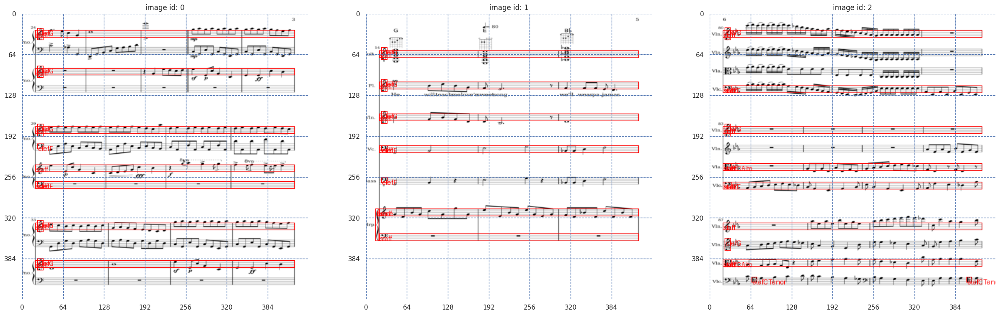

In [ ]:
depict_plt(S=7, out=test, size=(30, 10), num_of=3)

In [ ]:
S = 26

In [ ]:
a = torch.cat(
    (
        dataset326[120][1].reshape(1, S * S * (5 * 2 + len(V3_LIST26))),
        dataset326[121][1].reshape(1, S * S * (5 * 2 + len(V3_LIST26))),
        dataset326[112][1].reshape(1, S * S * (5 * 2 + len(V3_LIST26)))
        ), dim=0
    )
x = torch.cat((dataset326[120][0].unsqueeze(0), dataset326[121][0].unsqueeze(0), dataset326[112][0].unsqueeze(0)), dim=0)
print(a.shape, x.shape)
print(dataset326[0][0].shape)

torch.Size([3, 10140]) torch.Size([3, 3, 416, 416])
torch.Size([3, 416, 416])


In [ ]:
test = translate_output(a, x, S, len(V3_LIST26))

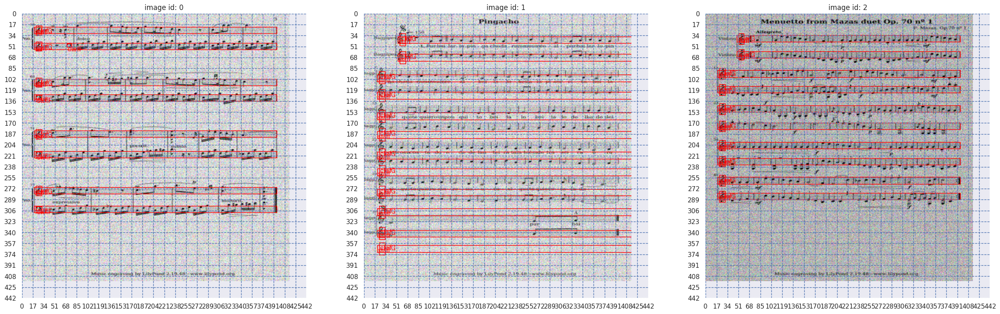

In [ ]:
depict_plt(S=S, out=test, size=(30, 10), num_of=3, version="V3_26")

In [ ]:
S = 52

In [ ]:
a = torch.cat(
    (
        valid_dataset352[0][1].reshape(1, S * S * (5 * 2 + len(V3_LIST52))),
        dataset352[121][1].reshape(1, S * S * (5 * 2 + len(V3_LIST52))),
        dataset352[112][1].reshape(1, S * S * (5 * 2 + len(V3_LIST52)))
        ), dim=0
    )
x = torch.cat((valid_dataset352[0][0].unsqueeze(0), dataset352[121][0].unsqueeze(0), dataset352[112][0].unsqueeze(0)), dim=0)
print(a.shape, x.shape)
print(dataset352[0][0].shape)

torch.Size([3, 348816]) torch.Size([3, 3, 416, 416])
torch.Size([3, 416, 416])


In [ ]:
test = translate_output(a, x, S, len(V3_LIST52))

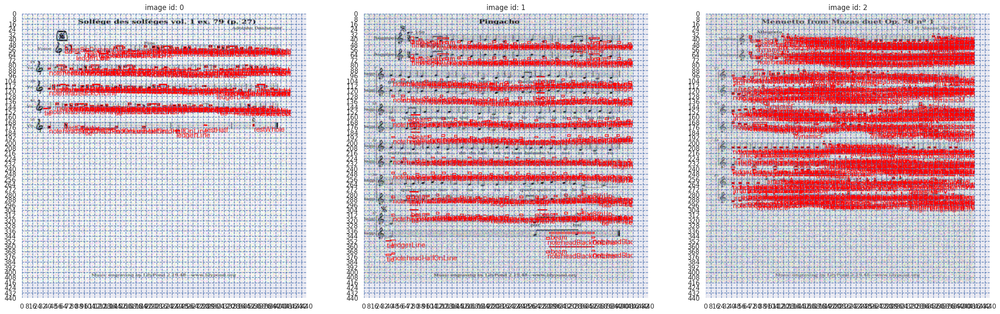

In [ ]:
depict_plt(S=S, out=test, size=(30, 10), num_of=3, version="V3_52")

## **☑ 3. YOLO Loss function**

### *Intersection over Union*

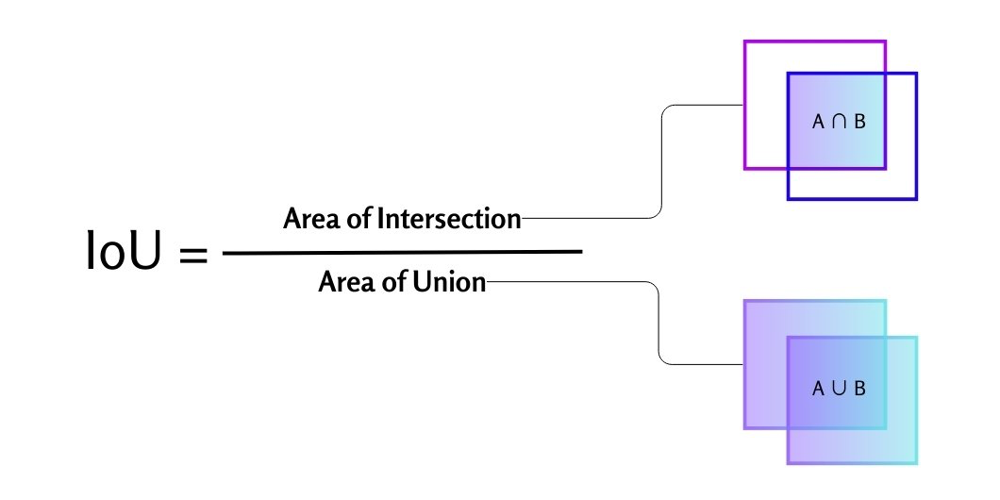

In [31]:
def area(x0: int, y0: int, x1: int, y1: int, intersection=False) -> int:

  height = x1 - x0
  width = y0 - y1
  if intersection:
    height = height.clamp(0)
    width = width.clamp(0)
  area = height * width
  return area

def IoU(real_box, predicted_box):
  # Real box | xc, yc, w, h
  xcr = real_box[... , 0].unsqueeze(-1)
  ycr = real_box[... , 1].unsqueeze(-1)
  wr = real_box[... , 2].unsqueeze(-1)
  hr = real_box[... , 3].unsqueeze(-1)

  xr0, yr0 = xcr - (wr / 2), ycr + (hr / 2)
  xr1, yr1 = xcr + (wr / 2), ycr - (hr / 2)
  # Predicted box
  xcp = predicted_box[... , 0].unsqueeze(-1)
  ycp = predicted_box[... , 1].unsqueeze(-1)
  wp = predicted_box[... , 2].unsqueeze(-1)
  hp = predicted_box[... , 3].unsqueeze(-1)
  xp0, yp0 = xcp - (wp / 2), ycp + (hp / 2)
  xp1, yp1 = xcp + (wp / 2), ycp - (hp / 2)
  # Area of Intersection
  xi0, yi0 = torch.max(xr0, xp0), torch.min(yr0, yp0)
  xi1, yi1 = torch.min(xr1, xp1), torch.max(yr1, yp1)
  intersection_area = area(xi0, yi0, xi1, yi1, intersection=True)
  # print(intersection_area)

  # Area of Union
  real_area = abs(area(xr0, yr0, xr1, yr1))

  predicted_area = abs(area(xp0, yp0, xp1, yp1))
  # print(xr0 == xr1)
  union_area = real_area + predicted_area - intersection_area

  return(intersection_area / union_area)

<hr>

*TEST IOU*

In [32]:
a = torch.rand(3, 7, 7, 13)
b = torch.rand(3, 7, 7, 13)
iou = IoU(a, b)
print(iou[0][0], iou.shape)

tensor([[0.0000],
        [0.0000],
        [0.0000],
        [0.0197],
        [0.1757],
        [0.0000],
        [0.0270]]) torch.Size([3, 7, 7, 1])


<hr>

### *LOSS FUNCTION*

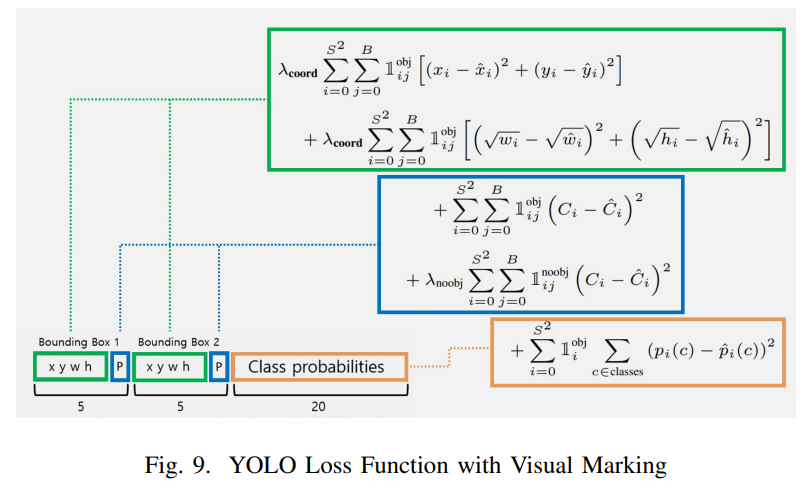

**[RUS]** Изничально в функцию поступает два тензора: предсказанные значени, которые преставляют собой тензор размерности `[BATCH_SIZE, S × S × (5 × B + C)]`, и реальные значения, которые преставляют собой тензор размерности `[S, S, 5 × B + C]`.
* *Шаг №1* Изменяем размерность тензора предсказанных значений.
* *Шаг №2* Вычисляем IoU предсказанных боксов и из них находим наибольшее значение, то есть определяем наиболее близкий к истине box (чем выше IoU тем больше площадь перекрытия).
* *Шаг №3* Реализация частей фукнции.

<hr>

Первая срока функции вычисляет расстояние между прогозируемым и предпологаемым центром. Вторая строка разницу между прогнозируемой шириной и высотой ограничивающей рамки и целевой шириной и высотой.

* 𝟙<sup>obj</sup><sub>ij</sub> -  функция идентификации, возвращиет 1 если объект существует в клетке и ноль соответственно если объект не существует.

* 𝟙<sup>noobj</sup><sub>ij</sub> обратна 𝟙<sup>obj</sup><sub>ij</sub> , следовательно если 𝟙<sup>obj</sup><sub>ij</sub> = 0, то 𝟙<sup>noobj</sup><sub>ij</sub> = 1


> " Значительное отклонение в небольших ящиках будет небольшим, в то время как небольшое отклонение в более крупных ящиках будет значительным, из-за чего небольшие ящики будут иметь меньшее значение. Поэтому авторы добавили квадратный корень, чтобы отразить тот факт, что небольшие отклонения в больших ящиках имеют меньшее значение, чем в небольших. " [[4]](https://pyimagesearch.com/2022/04/11/understanding-a-real-time-object-detection-network-you-only-look-once-yolov1/)



> "В третьей части приведенного уравнения [...] вычисляем потерю между прогнозируемым показателем достоверности ограничивающей рамки и целевой показатель достоверности. Здесь целевой показатель достоверности C равно значению IOU между прогнозируемой ограничивающей рамкой и целью. Мы выбираем оценку достоверности рамки, у которой более высокое значение IOU с целью." [[4]](https://pyimagesearch.com/2022/04/11/understanding-a-real-time-object-detection-network-you-only-look-once-yolov1/)



> "Далее, если в ячейке сетки нет объекта, то третья часть уравнения будет равна нулю. Потери вычисляются между рамкой с более высоким показателем IoU и целевой рамкой C, который является 0 поскольку мы хотим, чтобы достоверность для ячейки без объекта была 0. Mы также взвешиваем эту часть с λ<sub>noobj</sub> = 0.5 поскольку может быть много ячеек сетки, в которых нет объектов, и мы не хотим, чтобы этот термин подавлял градиенты для ячеек, содержащих объекты. Как подчёркивается в статье, это может привести к нестабильности модели и усложнить оптимизацию." [[4]](https://pyimagesearch.com/2022/04/11/understanding-a-real-time-object-detection-network-you-only-look-once-yolov1/)

В конце мы вычисляем потери для всех классов ( *SSE** )

* λ<sub>noobj</sub> = lambda_noobj

* λ<sub>coord</sub> = lambda_coord

**Classification loss(highlighted in orange in the picture) is equal to SSE(Sum Squared Error loss or L2 loss).*




In [33]:
class YOLOLoss(nn.Module):
  def __init__(self, S: int=7, C: int=20, B: int=2, version: str="V1") -> None:  # as it was in original article
    super().__init__()
    self._mse = nn.MSELoss(reduction="sum")  # Settung reduction = "sum" avoids the devisoin by N
    self.S = S  # grid size
    self.C = C  # number of classes
    self.B = B  # number of boxes
    self.delta_coord = 5
    self.delta_noobj = 0.5
    self._version = version

  def forward(self, pred, true_pred):
    if self._version == "V1":
      pred = pred.reshape(-1, self.S, self.S, (5 * self.B + self.C))  # Step №1
    ious = list()
    for step_b in range(self.B):
      iou = IoU(pred[... , (0 + step_b * 5):(4 + step_b * 5)], true_pred[... , 0:4])
      ious.append(iou.unsqueeze(0))
    ious = torch.cat(ious, dim=0)
    # Step №2
    max_iou, best_boxes = torch.max(ious, dim=0)  # return max value and index (in this case indexes of the best boxes)
    obj = true_pred[... , 4].unsqueeze(3)  # 1obj on pic // exictance score of boxes
    noobj = 1 - obj
    box_pred = (
        ((1 - best_boxes) * pred[... , 0:4]) + (best_boxes * pred[... , 5:9])
    ) * obj
    box_true = obj * true_pred[... , 0:4]  # we should take only thoce boxes which exist (have an obj in them)
    # Step №3
    # ----------------- LOCALIZATION LOSS ------------------
    box_pred = box_pred.clone()
    box_pred[... , 2:4] = torch.sign(box_pred[... , 2:4]) * torch.sqrt(torch.abs(box_pred[... , 2:4] + 1e-6))
    box_true = box_true.clone()
    box_true[... , 2:4] = torch.sqrt(box_true[... , 2:4])
    # print(torch.flatten(box_true, end_dim=-2).shape)

    loc_loss = self._mse(
        torch.flatten(box_pred, end_dim=-2),
        torch.flatten(box_true, end_dim=-2),
    )
    # -------------------------------------------------------
    # ----------------- CONFIDANCE LOSS ---------------------
    confidence_pred = (
        ((1 - best_boxes) * pred[... , 4:5]) + (best_boxes * pred[... , 9:10])
    ) * obj  # obj
    confidence_true = obj * true_pred[... , 4:5]
    obj_conf_loss = self._mse(
        torch.flatten(confidence_pred),
        torch.flatten(confidence_true),
        )

    noobj_conf_loss = self._mse(
        torch.flatten(noobj * pred[... , 4:5], start_dim=1),
        torch.flatten(noobj * true_pred[... , 4:5], start_dim=1),
        )
    noobj_conf_loss = noobj_conf_loss + self._mse(
        torch.flatten(noobj * pred[... , 9:10], start_dim=1),
        torch.flatten(noobj * true_pred[... , 4:5], start_dim=1),
        )
    # -------------------------------------------------------
    # -------------------- CLASS LOSS -----------------------
    pred_classes = obj * pred[..., (5 * self.B):]
    true_classes = obj * true_pred[..., (5 * self.B):]
    class_loss = self._mse(
        torch.flatten(pred_classes, end_dim=-2),
        torch.flatten(true_classes, end_dim=-2),
        )
    # -------------------------------------------------------
    loss = (
        (loc_loss * self.delta_coord)
        + obj_conf_loss
        + (noobj_conf_loss * self.delta_noobj)
        + class_loss
    )
    return loss

<hr>

*TEST LOSS*

In [ ]:
pred_test = torch.cat(
    (
        dataset2[0][1].reshape(1, 7 * 7 * (5 * 2 + len(V1_LIST))),
        dataset2[1][1].reshape(1, 7 * 7 * (5 * 2 + len(V1_LIST))),
        dataset2[2][1].reshape(1, 7 * 7 * (5 * 2 + len(V1_LIST)))
        ), dim=0
    )
true_test = torch.stack((dataset2[0][1], dataset2[1][1], dataset2[2][1]))
loss_fn = YOLOLoss(7, len(V1_LIST), 2)
loss = loss_fn(pred_test, true_test)
loss

tensor(4.9570e-10)

In [ ]:
true_test = torch.stack((dataset2[0][1], dataset2[1][1], dataset2[2][1]))
true_test_x = torch.stack((dataset2[0][0], dataset2[1][0], dataset2[2][0]))
pred_test = yolov1(true_test_x)
loss_fn = YOLOLoss(7, len(V1_LIST), 2)
loss = loss_fn(pred_test.to(device), true_test.to(device))
print(loss)

tensor(856.8366, grad_fn=<AddBackward0>)


## **4. Training**

### *Yolov1*

In [ ]:
loss_func = YOLOLoss(7, len(V1_LIST), 2)
optimizer = optim.Adam(yolov1.parameters(), lr=LR, weight_decay=0)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer=optimizer, factor=0.1, patience=3, mode='max', verbose=True)

/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


<p> Model + Dataset size (on CUDA) = 1.6 &#177; 0.2 GB </p>

<hr>

In [ ]:
epoch = int(input("Epoch: "))
file_name =  f"YOLOv1_params_ep{epoch}.pt"
yolov1, optimizer = load_chekpoint(yolov1, file_name, optimizer)

<hr>

In [ ]:
fit("YOLOv1", yolov1, train_loader, loss_func, optimizer, EPOCHS, 5)

*The model was trained on a local computer. Results:*

Unfortunately, only train loss was saved:

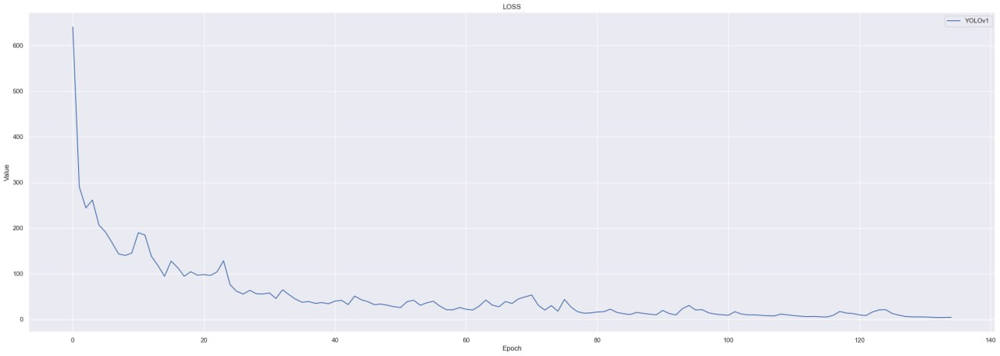

Predictions on the train sample in 135th epoch:

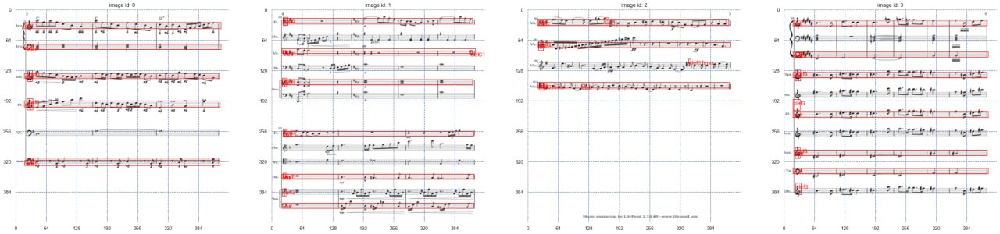

Loss: 4.5992279052734375

### *Yolov3 -> 26*

In [ ]:
loss_func = YOLOLoss(26, len(V3_LIST26), 2, version="V3_26")
optimizer = optim.Adam(yolov3_first.parameters(), lr=LR, weight_decay=0)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer=optimizer, factor=0.1, patience=3, mode='max', verbose=True)

/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


In [ ]:
fit("YOLOv3_medium", yolov3_first, train_loader326, valid_loader26, loss_func, optimizer, EPOCHS, 5, ver="V3_26")

*The model was trained on a local computer. Results:*

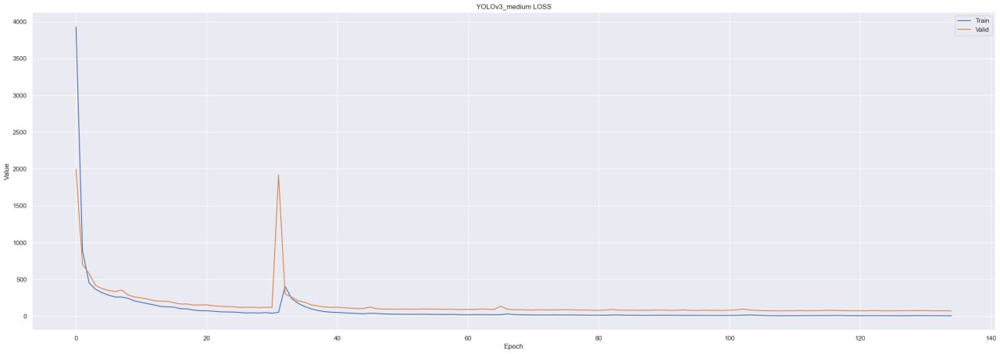

Retraining occurs around the 30th epoch, so in the final work, we use the weights stored at this epoch.

Predictions on the valid sample in 30th epoch:

Loading model...
----------------------------------------------------------------------------------------------------------------------------------


<ipython-input-44-f9886732daae>:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state = torch.load(os.path.join(SAVE_PATH, file_name), map_location=torch.device(device))


Complite. Current epoch: 29. 	 	 	 	 Avg loss: 48.796836853027344
----------------------------------------------------------------------------------------------------------------------------------
Predictions:


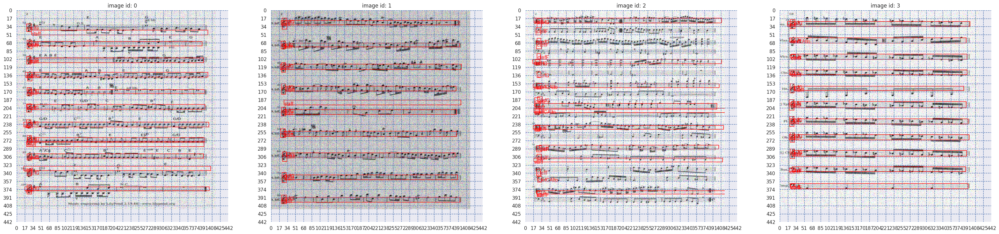

In [ ]:
load_chekpoint(yolov3_first, "YOLOv3_medium_params_ep29.pt")
show_example(yolov3_first, valid_loader26, 4, ver="V3_26")

### *Yolov3 -> 52*

In [34]:
loss_func = YOLOLoss(52, len(V3_LIST52), 2, version="V3_52")
optimizer = optim.Adam(yolov3_second.parameters(), lr=LR, weight_decay=0)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer=optimizer, factor=0.1, patience=3, mode='max', verbose=True)

/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


In [ ]:
fit("YOLOv3_large", yolov3_second, train_loader352, valid_loader352, loss_func, optimizer, EPOCHS, 5, ver="V3_52")

*The model was trained on a local computer. Results:*

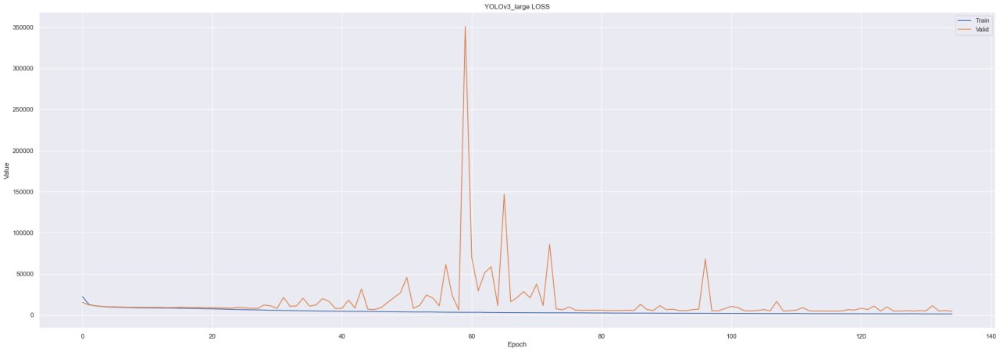

Predictions on the valid sample in 114th epoch:

Loading model...
----------------------------------------------------------------------------------------------------------------------------------


<ipython-input-28-f9886732daae>:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state = torch.load(os.path.join(SAVE_PATH, file_name), map_location=torch.device(device))


Complite. Current epoch: 114. 	 	 	 	 Avg loss: 1542.0062255859375
----------------------------------------------------------------------------------------------------------------------------------
Predictions:


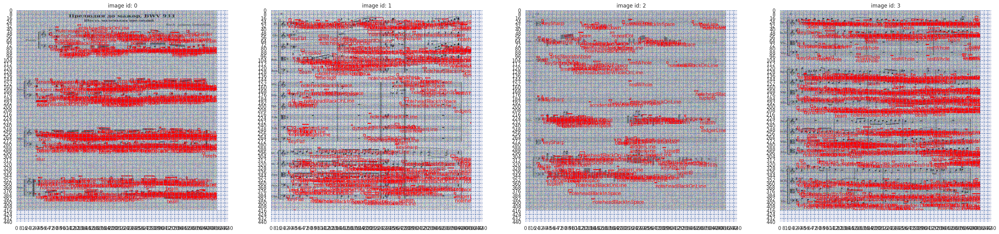

In [55]:
load_chekpoint(yolov3_second, "YOLOv3_large_params_ep114.pt")
show_example(yolov3_second, valid_loader352, 4, ver="V3_52")

Predictions:


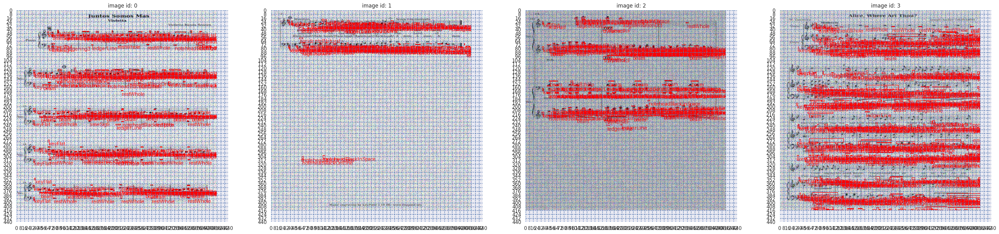

In [59]:
show_example(yolov3_second, train_loader352, 4, ver="V3_52")

## *☑ Clearing CUDA*

In [ ]:
import gc
del yolov3_first, yolov3_second, loss_func, optimizer, train_loader326, train_loader352, valid_loader326, valid_loader352, yolov1
gc.collect()
torch.cuda.empty_cache()

In [ ]:
gc.collect()
torch.cuda.empty_cache()

## **5. Load weights**

In [ ]:
load_chekpoint(yolov3_first, "YOLOv3_medium_params_ep34.pt")

In [ ]:
image_tr = tr.Compose([
    tr.Grayscale(num_output_channels=3),
    # tr.RandomAdjustSharpness(sharpness_factor=2, p=0.3),
    tr.Resize(IMAGE_SIZE_V3),
    tr.ToTensor(),

    # tr.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225],),
])

In [ ]:
# show_example(yolov3_first, test_loader, 5, ver="V3_26")
img2 = Image.open(PATH_TEST)
img = image_tr(img2).unsqueeze(0).to(device)
print(img.shape)
pred, k2 = yolov3_first(img)
test = translate_output(pred, tr.ToTensor()(tr.Resize(IMAGE_SIZE_V3)(img2)).unsqueeze(0).to(device), 26, len(V3_LIST26))

torch.Size([1, 3, 416, 416])


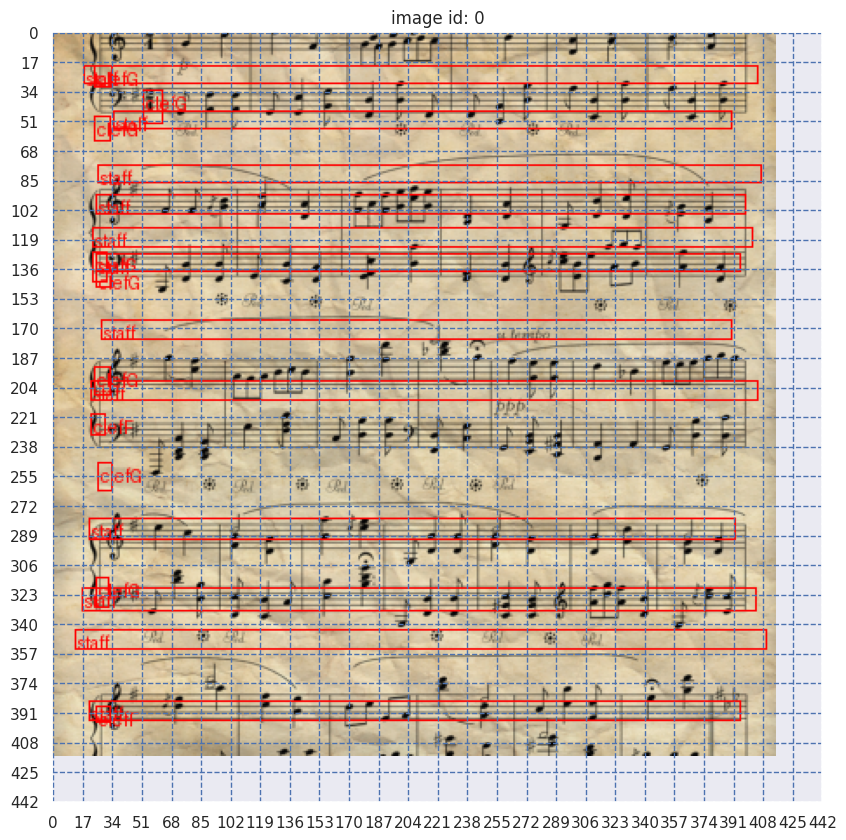

In [ ]:
depict_plt(S=26, out=test, size=(30, 10), num_of=1, version="V3_26")

# **Resource materials**



1.   Хабр ["Нейросети. Куда это все движется"](https://habr.com/ru/articles/482794/)  by FooBar167 | 04.01.2020
2.   GitHub ["OMR-Datasets"](https://github.com/apacha/OMR-Datasets)
3.   Хабр ["История YOLO – самой известной архитектуры компьютерного зрения"](https://habr.com/ru/articles/865834/) by DataSecrets | 11.12.2024
4.   [Understanding a Real-Time Object Detection Network: You Only Look Once (YOLOv1)](https://pyimagesearch.com/2022/04/11/understanding-a-real-time-object-detection-network-you-only-look-once-yolov1/) by Aditya Sharma | 11.04.2022
5. https://habr.com/ru/articles/556404/

